In [1]:
%pylab inline

import pandas as pd
import patsy as patsy
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn import preprocessing

# SMOTE
from imblearn.over_sampling import SMOTE

# Undersampling
from imblearn.under_sampling import RandomUnderSampler

from sklearn import linear_model
from sklearn import svm
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier

from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
from sklearn import metrics

import pickle

%config InlineBackend.figure_format = 'svg'
sns.set_style("white")

Populating the interactive namespace from numpy and matplotlib


In [2]:
with open("x_liv.pkl", 'rb') as picklefile: 
    x_liv = pickle.load(picklefile)

with open("y_liv.pkl", 'rb') as picklefile: 
    y_liv = pickle.load(picklefile)

with open("y_train_liv.pkl", 'rb') as picklefile: 
    y_train_liv = pickle.load(picklefile)

with open("y_test_liv.pkl", 'rb') as picklefile: 
    y_test_liv = pickle.load(picklefile)

with open("x_train_liv.pkl", 'rb') as picklefile: 
    x_train_liv = pickle.load(picklefile)

with open("x_test_liv.pkl", 'rb') as picklefile: 
    x_test_liv = pickle.load(picklefile)

with open("x_train_scaled_liv.pkl", 'rb') as picklefile: 
    x_train_scaled_liv = pickle.load(picklefile)

with open("x_test_scaled_liv.pkl", 'rb') as picklefile: 
    x_test_scaled_liv = pickle.load(picklefile)
    
with open("x_scaled_liv.pkl", 'rb') as picklefile: 
    x_scaled_liv = pickle.load(picklefile)

with open("patientdataICD9_liv.pkl", 'rb') as picklefile: 
    patientdataICD9_liv = pickle.load(picklefile)


In [3]:
# using the scaled x-train and x-test because it's Logistic
x_train = x_train_scaled_liv
y_train = y_train_liv
x_test = x_test_scaled_liv
y_test = y_test_liv
x = x_scaled_liv
y = y_liv

In [4]:
# Binarizing the classes
y = y.str.replace('>30','NO')
y_test = y_test.str.replace('>30','NO')
y_train = y_train.str.replace('>30','NO')

In [11]:
# pulling these in from pickle now

# x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.25, random_state=42, stratify=y)

In [5]:
# check out class_weight="balanced"

linearSVMmodel = svm.LinearSVC(class_weight="balanced")
linearSVMmodel.fit(x_train, y_train)

y_pred = linearSVMmodel.predict(x_test)

print("Accuracy: %.3f"% metrics.accuracy_score(y_test, y_pred))
print(metrics.classification_report(y_test, y_pred))

# Previous values from scaling before split:

#Accuracy: 0.555
#             precision    recall  f1-score   support

#        <30       0.24      0.20      0.22      2839
#        >30       0.48      0.44      0.46      8887
#         NO       0.65      0.70      0.67     13716

#avg / total       0.54      0.55      0.55     25442


Accuracy: 0.673
             precision    recall  f1-score   support

        <30       0.19      0.57      0.28      2839
         NO       0.93      0.69      0.79     22190

avg / total       0.84      0.67      0.73     25029



In [20]:
# check out class_weight="balanced"
RBFSVMmodel = svm.SVC(class_weight="balanced")
RBFSVMmodel.fit(x_train, y_train)

y_pred = RBFSVMmodel.predict(x_test)

print("Accuracy: %.3f"% metrics.accuracy_score(y_test, y_pred))
print(metrics.classification_report(y_test, y_pred))

Accuracy: 0.520
             precision    recall  f1-score   support

        <30       0.21      0.38      0.27      2839
        >30       0.48      0.43      0.45      8887
         NO       0.68      0.61      0.64     13716

avg / total       0.56      0.52      0.53     25442



#### SMOTE:

In [9]:
sm = SMOTE(random_state=42)
x_train_smote, y_train_smote = sm.fit_sample(x_train, y_train)

#### Linear SVM with SMOTE:

In [10]:
# x_train_smote, y_train_smote

linearSVMmodel = svm.LinearSVC(class_weight="balanced")
linearSVMmodel.fit(x_train_smote, y_train_smote)

y_pred = linearSVMmodel.predict(x_test)

print("Accuracy: %.3f"% metrics.accuracy_score(y_test, y_pred))
print(metrics.classification_report(y_test, y_pred))

Accuracy: 0.644
             precision    recall  f1-score   support

        <30       0.18      0.58      0.27      2839
         NO       0.92      0.65      0.76     22190

avg / total       0.84      0.64      0.71     25029



#### Kernel RBF SVM with SMOTE:

In [23]:
# check out class_weight="balanced"
RBFSVMmodel = svm.SVC(class_weight="balanced")
RBFSVMmodel.fit(x_train_smote, y_train_smote)

y_pred = RBFSVMmodel.predict(x_test)

print("Accuracy: %.3f"% metrics.accuracy_score(y_test, y_pred))
print(metrics.classification_report(y_test, y_pred))

Accuracy: 0.697
             precision    recall  f1-score   support

        <30       0.19      0.50      0.27      2839
         NO       0.92      0.72      0.81     22190

avg / total       0.84      0.70      0.75     25029



#### Random undersampling:

In [6]:
rus = RandomUnderSampler(random_state=0)
x_train_undersampled, y_train_undersampled = rus.fit_sample(x_train, y_train)

#### Linear SVM with random undersampling:

In [7]:
# x_train_smote, y_train_smote

# using class_weight="balanced" is not actually necessary here
# since the samples are equal now, but hopefully it's not hurting anything

linearSVMmodel = svm.LinearSVC(class_weight="balanced")
linearSVMmodel.fit(x_train_undersampled, y_train_undersampled)

y_pred = linearSVMmodel.predict(x_test)

print("Accuracy: %.3f"% metrics.accuracy_score(y_test, y_pred))
print(metrics.classification_report(y_test, y_pred))

Accuracy: 0.661
             precision    recall  f1-score   support

        <30       0.18      0.58      0.28      2839
         NO       0.93      0.67      0.78     22190

avg / total       0.84      0.66      0.72     25029



#### Kernel RBF SVM with random undersampling:

In [22]:
# check out class_weight="balanced"
RBFSVMmodel = svm.SVC(class_weight="balanced")
RBFSVMmodel.fit(x_train_undersampled, y_train_undersampled)

y_pred = RBFSVMmodel.predict(x_test)

print("Accuracy: %.3f"% metrics.accuracy_score(y_test, y_pred))
print(metrics.classification_report(y_test, y_pred))

Accuracy: 0.673
             precision    recall  f1-score   support

        <30       0.19      0.56      0.28      2839
         NO       0.92      0.69      0.79     22190

avg / total       0.84      0.67      0.73     25029



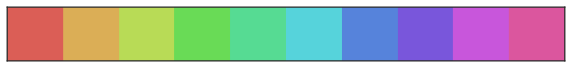

In [18]:
y_colors = sns.color_palette("hls", 10)
sns.palplot(y_colors)

In [19]:
from sklearn import decomposition

In [45]:
def plot_PCA_2D(data, target):

    pca = decomposition.PCA(n_components=2)
    pca.fit(data)
    pcafeatures = pca.transform(data)
    
    print(pcafeatures)
    
    target_labels = unique(target)
    
    for i, label in enumerate(target_labels):
        plt.scatter(pcafeatures[target == i, 0], pcafeatures[target == i, 1],
                   c=y_colors[i], label=label, alpha=.5, edgecolors="none")

    xlabel("1st pricinple component")
    ylabel("2nd pricinple component")
    plt.legend()
    plt.show()

In [47]:
from sklearn import datasets

iris = datasets.load_iris()
xiris = iris.data
yiris = iris.target

In [49]:
xiris

array([[5.1, 3.5, 1.4, 0.2],
       [4.9, 3. , 1.4, 0.2],
       [4.7, 3.2, 1.3, 0.2],
       [4.6, 3.1, 1.5, 0.2],
       [5. , 3.6, 1.4, 0.2],
       [5.4, 3.9, 1.7, 0.4],
       [4.6, 3.4, 1.4, 0.3],
       [5. , 3.4, 1.5, 0.2],
       [4.4, 2.9, 1.4, 0.2],
       [4.9, 3.1, 1.5, 0.1],
       [5.4, 3.7, 1.5, 0.2],
       [4.8, 3.4, 1.6, 0.2],
       [4.8, 3. , 1.4, 0.1],
       [4.3, 3. , 1.1, 0.1],
       [5.8, 4. , 1.2, 0.2],
       [5.7, 4.4, 1.5, 0.4],
       [5.4, 3.9, 1.3, 0.4],
       [5.1, 3.5, 1.4, 0.3],
       [5.7, 3.8, 1.7, 0.3],
       [5.1, 3.8, 1.5, 0.3],
       [5.4, 3.4, 1.7, 0.2],
       [5.1, 3.7, 1.5, 0.4],
       [4.6, 3.6, 1. , 0.2],
       [5.1, 3.3, 1.7, 0.5],
       [4.8, 3.4, 1.9, 0.2],
       [5. , 3. , 1.6, 0.2],
       [5. , 3.4, 1.6, 0.4],
       [5.2, 3.5, 1.5, 0.2],
       [5.2, 3.4, 1.4, 0.2],
       [4.7, 3.2, 1.6, 0.2],
       [4.8, 3.1, 1.6, 0.2],
       [5.4, 3.4, 1.5, 0.4],
       [5.2, 4.1, 1.5, 0.1],
       [5.5, 4.2, 1.4, 0.2],
       [4.9, 3

In [52]:
#y_train.as_matrix()
y_train.values

array(['1', '1', '1', ..., '1', '0', '1'], dtype=object)

[[-0.4187111  -0.16107947]
 [-0.54959594 -0.20115126]
 [ 0.7174617  -0.32229389]
 ...
 [-1.12875372 -1.38704452]
 [-0.29329758  1.51827547]
 [-1.71407754 -0.39995577]]


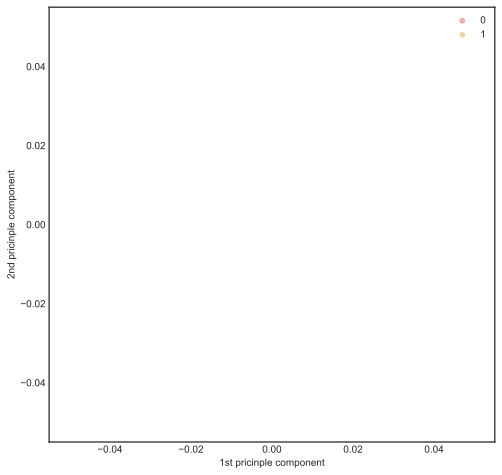

In [56]:
figsize(8,8)
plot_PCA_2D(x_train.values, y_train.values)

In [38]:
#y_train = y_train.str.replace('<30','0')
#y_train = y_train.str.replace('NO','1')
#y_train.head()

43670    1
23049    1
14557    1
54888    0
86170    0
Name: readmitted, dtype: object

In [39]:
y_train.head()

43670    1
23049    1
14557    1
54888    0
86170    0
Name: readmitted, dtype: object

In [42]:
x.head()

,Intercept,race[T.AfricanAmerican],race[T.Asian],race[T.Caucasian],race[T.Hispanic],race[T.Other],gender[T.Male],gender[T.Unknown/Invalid],age[T.[10-20)],age[T.[20-30)],...,change[T.No],diabetesMed[T.Yes],time_in_hospital,num_lab_procedures,num_procedures,num_medications,number_outpatient,number_emergency,number_inpatient,number_diagnoses
0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,-1.139562,-0.099043,-0.782651,-1.851329,-0.292270,-0.212001,-0.501518,-3.306628
1,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,1.0,-0.467184,0.818349,-0.782651,0.249390,-0.292270,-0.212001,-0.501518,0.820747
2,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,1.0,1.0,-0.803373,-1.628029,2.158047,-0.368469,1.290009,-0.212001,0.290984,-0.727018
3,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,1.0,-0.803373,0.053856,-0.194511,0.002246,-0.292270,-0.212001,-0.501518,-0.211096
4,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,1.0,-1.139562,0.410619,-0.782651,-0.986327,-0.292270,-0.212001,-0.501518,-1.242940


coefficient plots

EDA plots

PCA

hypothetical examples

D3 tooltip (mouse over each point/patient to see what the values for the top 10 coefficients are)

blocks.org

In [54]:
list(y_train)

['1',
 '1',
 '1',
 '0',
 '0',
 '1',
 '1',
 '1',
 '1',
 '0',
 '0',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '0',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '0',
 '1',
 '1',
 '1',
 '0',
 '1',
 '0',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '0',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '0',
 '1',
 '1',
 '1',
 '0',
 '1',
 '1',
 '1',
 '1',
 '0',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '0',
 '1',
 '1',
 '0',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '0',
 '1',
 '0',
 '1',
 '1',
 '1',
 '1',
 '0',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '0',
 '1',
 '1',
 '1',
 '1',
 '0',
 '0',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '0',
 '1',
 '1',
 '0',
 '0',
 '1',
 '1',
 '1',
 '0',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '0',
 '1',
 '1',
 '0',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1',
 '1'

In [5]:
from sklearn.decomposition import PCA
pca = PCA(n_components=2)
pca.fit(x)
print(pca.explained_variance_)

[2.09461692 1.4136112 ]


In [6]:
projected = pca.fit_transform(x)

In [7]:
projected

array([[-3.29866764, -0.75503068],
       [ 0.15965878,  0.18850771],
       [-0.89453888, -0.34237365],
       ...,
       [-0.054507  ,  1.04574772],
       [ 2.03399467, -0.03098891],
       [-0.82744393, -0.48750009]])

In [70]:
plt.scatter(projected[:, 0], projected[:, 1])

In [67]:
len(y.unique())

2

In [9]:
y.values

array(['NO', 'NO', 'NO', ..., 'NO', 'NO', 'NO'], dtype=object)

In [11]:
cmap = plt.cm.get_cmap('Set1', len(y.unique()))

In [13]:
cmap

TypeError: object of type 'ListedColormap' has no len()

In [15]:
y = y.str.replace('<30','1.0')
y = y.str.replace('NO','0.0')
#y_train.head()

In [16]:
plt.scatter(projected[:, 0], projected[:, 1],
            c=y.as_matrix(), edgecolor='none', alpha=0.5,
            cmap=plt.cm.get_cmap('Set1', len(y.unique())))
plt.xlabel('component 1')
plt.ylabel('component 2')
plt.colorbar();

In [ ]:
from sklearn.decomposition import PCA as sklearnPCA
sklearn_pca = sklearnPCA(n_components=2)
Y_sklearn = sklearn_pca.fit_transform(X_std)
with plt.style.context('seaborn-whitegrid'):
    plt.figure(figsize=(6, 4))
    for lab, col in zip(('Iris-setosa', 'Iris-versicolor', 'Iris-virginica'),
                        ('blue', 'red', 'green')):
        plt.scatter(Y_sklearn[y==lab, 0],
                    Y_sklearn[y==lab, 1],
                    label=lab,
                    c=col)
    plt.xlabel('Principal Component 1')
    plt.ylabel('Principal Component 2')
    plt.legend(loc='lower center')
    plt.tight_layout()
    plt.show()